# longyearbyen_test

In [125]:
%load_ext autoreload
%autoreload 2
#import os
#import sys
#module_path = os.path.abspath(os.path.join('..'))
#if module_path not in sys.path:
#    sys.path.append(module_path)
#import oogeso
from oogeso.io import file_io
import oogeso.plots as plots
from oogeso.utils import create_time_series_data
import oogeso.dto
import matplotlib.pyplot as plt
import IPython.display
#import numpy as np
import pandas as pd
import logging
import pprint
import ipywidgets
import pickle
import plotly.express as px
import pyomo.environ as pyo
from dataclasses import asdict

logging.basicConfig()
logger = logging.getLogger()
logger.setLevel('INFO') #INFO
#print("Using Oogeso version {}".format(oogeso.__version__))


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Read input data

In [126]:
first = pd.read_csv('../tests/test_data/LYR_load.csv')
second = pd.read_csv('../tests/test_data/cap_factors_1hr_airport.csv')
third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')

merged = pd.merge(first, second, how='left', on='timestamp')
merged = pd.merge(merged, third, how='left', on='timestamp')
merged.fillna(0,inplace=True)
#merged.to_csv('../tests/test_data/profiles_merged.csv', index=False)

In [127]:
merged.set_index(merged["timestamp"], inplace=True)
#merged

In [128]:
#case='base' # base case without wind
#case='A' # case with 24 MW wind capacity
#case='B' # case with 24 MW wind capacity AND 4 MW, 4 MWh battery
#case="_base_test"
case="_ir_offshore_pv"
case="_ir_offshore_pv_diesel"
case="_br_offshore_pv_diesel"
case="_br_offshore_pv_diesel_2018"
#case="all"
#timerange=[0,12*24*7] #one week (with 5 min timestep)
timerange=[0,24*365] #one year (with 1 hour timestep)
#timerange=[0,24*7*50] #50 weeks (with 1 hour timestep)
#timerange=[0,24*7] #one week (with 1 hour timestep)
#timerange=[0,4]
#timerange=[1030,1050] #no wind period

outpath = "result/"
plots.plotter="plotly"

data = file_io.read_data_from_yaml('../tests/test_data/longyearbyen_test.yaml')

incl_battery=0
incl_hydrogen=0
incl_diesel=0

if case=="_ir_offshore_pv":
    # Combine profiles
    first = pd.read_csv('../tests/test_data/LYR_load.csv')
    second = pd.read_csv('../tests/test_data/cap_factors_1hr_ir.csv')
    third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
    merged = pd.merge(first, second, how='left', on='timestamp')
    merged = pd.merge(merged, third, how='left', on='timestamp')
    merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    wind_P_max=3.45*5 # MW, 5 Vestas V105 turbines
    wind_profile="V105" # Offshore wind profile name with Isfjord Radio data
    pv_P_max=25 # MWp, Sun on all roofs
    incl_hydrogen=1
    incl_battery=1
    data.parameters.co2_tax=1000
    #prof_h2target=oogeso.dto.oogeso_input_data_objects.TimeSeriesData(id="h2target",data=[0.5]*len(data.profiles[0].data))
    #data.profiles.append(prof_h2target)

elif case=="_ir_offshore_pv_diesel":
    # Combine profiles
    first = pd.read_csv('../tests/test_data/LYR_load.csv')
    second = pd.read_csv('../tests/test_data/cap_factors_1hr_ir.csv')
    third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
    merged = pd.merge(first, second, how='left', on='timestamp')
    merged = pd.merge(merged, third, how='left', on='timestamp')
    merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    wind_P_max=3.45*5 # MW, 5 Vestas V105 turbines
    wind_profile="V105" # Offshore wind profile name with Isfjord Radio data
    pv_P_max=25 # MWp, Sun on all roofs
    incl_hydrogen=1
    incl_battery=1
    incl_diesel=1
    data.parameters.co2_tax=1000

elif case=="_br_offshore_pv_diesel_2018":
    # Combine profiles
    first = pd.read_csv('../tests/test_data/LYR_load.csv')
    second = pd.read_csv('../tests/test_data/cap_factors_1hr_br.csv')
    third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
    merged = pd.merge(first, second, how='left', on='timestamp')
    merged = pd.merge(merged, third, how='left', on='timestamp')
    merged.set_index(merged["timestamp"], inplace=True)
    merged = merged['2018-01-01':]
    merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    timerange = [0,min(24*365,len(merged)-data.parameters.planning_horizon)]
    wind_P_max=3.45*10 # MW, 10 Vestas V105 turbines
    wind_profile="V105" # wind profile name with Breinosa data
    pv_P_max=25 # MWp, Sun on all roofs
    incl_hydrogen=1
    incl_battery=1
    incl_diesel=1
    data.parameters.co2_tax=1000

# Create profiles
timeseries = file_io.read_profiles_from_csv(
    filename_forecasts="../tests/test_data/profiles"+case+".csv",
    dayfirst = False)
profiles = create_time_series_data(
    df_forecast=timeseries["forecast"],
    df_nowcast=timeseries["forecast"],
    time_start=None,time_end=None,
    timestep_minutes=60,
    resample_method="linear")
data.profiles = profiles

#data['paramParameters']['planning_horizon']=12

if case=="base_test":
    wind_P_max=0.66*8 # Some turbines
    pv_P_max=25 # MWp Sun on all roofs
    incl_hydrogen=1
    incl_battery=1
    data.parameters.co2_tax=1000
    #prof_h2target=oogeso.dto.oogeso_input_data_objects.TimeSeriesData(id="h2target",data=[0.5]*len(data.profiles[0].data))
    #data.profiles.append(prof_h2target)
elif case=="all":
    # CASE for illustration (to make plots for paper)
    wind_P_max=8*12 # Large wind farm Pmax=2x demand
    incl_battery=1
    incl_hydrogen=1
    data.parameters.co2_tax=1000
    prof_h2target=oogeso.dto.oogeso_input_data_objects.TimeSeriesData(id="h2target",data=[0.5]*len(data.profiles[0].data))
    data.profiles.append(prof_h2target)


hydrogendevices = ['electrolyser','fuelcell','h2_storage']
dieseldevices = ['diesel_source','backup_east_1','backup_east_2','backup_east_3','backup_west_1','backup_west_2','backup_west_3','diesel_boiler_1','diesel_boiler_2','boiler_houses']
for dev in data.devices:
    if dev.id == "wind":
        dev.flow_max = wind_P_max
        dev.profile = wind_profile
    if dev.id == "pv":
        dev.flow_max = pv_P_max
    if dev.id == "el_storage":
        dev.include = incl_battery
    if dev.id in hydrogendevices:
        dev.include = incl_hydrogen
    if dev.id in dieseldevices:
        dev.include = incl_diesel

simulator = oogeso.Simulator(data)

In [129]:
data.profiles[3]

TimeSeriesData(id='V105', data=[0.3016875616463776, 0.1954242742082957, 0.1099562503393206, 0.0665351488979979, 0.4567641735985081, 0.5962277007829784, 0.6843175550761985, 0.679783760135833, 0.1122367186633388, 0.0167122546392067, 0.163424970316544, 0.2746161267310553, 0.2106276489607526, 0.4759373347024079, 0.3422724288603633, 0.2880507980374436, 0.2752187726853001, 0.2984504334291053, 0.2518150252889376, 0.2162473361474193, 0.1890570941676249, 0.2086455935911018, 0.0921256023188865, 0.07365354133739, 0.138532043151581, 0.268026828490675, 0.346174616027725, 0.2289324818033535, 0.2039441356286003, 0.1417116765674681, 0.2873568041550519, 0.3125110842739191, 0.3780674799302292, 0.504662583541307, 0.2284579970424313, 0.1406335460255517, 0.1141629809929481, 0.0373858599467971, 0.0331850267191302, 0.0300533388504773, 0.0230375566232123, 0.0735335313781999, 0.1091632056329348, 0.0659627509101159, 0.0896055266085108, 0.0768154379007347, 0.0904996767514592, 0.1131546830456067, 0.10749308448465

In [130]:
for dev in data.devices:
    if dev.id=='el_load':
        print(dev)

id='el_load' node_id='load' name='general el load' include=True profile='el_load' flow_min=1.0 flow_max=1.0 max_ramp_down=None max_ramp_up=None start_stop=None reserve_factor=0.0 op_cost=None penalty_function=None model=<ModelType.SINK_EL: 'sinkel'>


In [131]:
# Test solve:
simulator.optimiser.solve(solver="gurobi")

{'Problem': [{'Name': 'x140661', 'Lower bound': 0.0026699897129296994, 'Upper bound': 0.0026699897129297857, 'Number of objectives': 1, 'Number of constraints': 32619, 'Number of variables': 30962, 'Number of binary variables': 8160, 'Number of integer variables': 8160, 'Number of continuous variables': 22802, 'Number of nonzeros': 71130, 'Sense': 'minimize'}], 'Solver': [{'Status': 'ok', 'Return code': '0', 'Message': 'Model was solved to optimality (subject to tolerances), and an optimal solution is available.', 'Termination condition': 'optimal', 'Termination message': 'Model was solved to optimality (subject to tolerances), and an optimal solution is available.', 'Wall time': '0.20696258544921875', 'Error rc': 0, 'Time': 0.7989988327026367}], 'Solution': [OrderedDict([('number of solutions', 0), ('number of solutions displayed', 0)])]}

In [132]:
#simulator.optimiser.constr_diesel_source_flowMin.pprint()

In [133]:
simulator.optimiser.paramDeviceEnergyInitially.pprint()

paramDeviceEnergyInitially : Size=20, Index=setDevice, Domain=Reals, Default=None, Mutable=True
    Key             : Value
      backup_east_1 :         0
      backup_east_2 :         0
      backup_east_3 :         0
      backup_west_1 :         0
      backup_west_2 :         0
      backup_west_3 :         0
      boiler_houses :         0
    diesel_boiler_1 :         0
    diesel_boiler_2 :         0
      diesel_source :         0
            el_load :         0
         el_storage :       3.0
       electrolyser :         0
           fuelcell :         0
         h2_storage : 1500000.0
          heat_dump :         0
          heat_load :         0
           heatpump :         0
                 pv :         0
               wind :         0


In [134]:
simulator.optimiser.dual.pprint()

dual : Direction=Suffix.IMPORT, Datatype=Suffix.FLOAT
    Key : Value


In [135]:
simulator.optimiser.paramProfiles.pprint() # all 1 before update, from profile after
simulator.optimiser.paramDeviceIsOnInitially.pprint() # all 1 before and after update
simulator.optimiser.paramDevicePrepTimestepsInitially.pprint() # all 0 before and after update
simulator.optimiser.paramDevicePowerInitially.pprint() # unchanged before/after

paramProfiles : Size=960, Index=paramProfiles_index, Domain=Reals, Default=None, Mutable=True
    Key                : Value
             ('PV', 0) :     1
             ('PV', 1) :     1
             ('PV', 2) :     1
             ('PV', 3) :     1
             ('PV', 4) :     1
             ('PV', 5) :     1
             ('PV', 6) :     1
             ('PV', 7) :     1
             ('PV', 8) :     1
             ('PV', 9) :     1
            ('PV', 10) :     1
            ('PV', 11) :     1
            ('PV', 12) :     1
            ('PV', 13) :     1
            ('PV', 14) :     1
            ('PV', 15) :     1
            ('PV', 16) :     1
            ('PV', 17) :     1
            ('PV', 18) :     1
            ('PV', 19) :     1
            ('PV', 20) :     1
            ('PV', 21) :     1
            ('PV', 22) :     1
            ('PV', 23) :     1
            ('PV', 24) :     1
            ('PV', 25) :     1
            ('PV', 26) :     1
            ('PV', 27) :     1
       

### Inspect input data

In [136]:
@ipywidgets.interact(datagroup=['','devices','nodes','edges','carriers','parameters'])
def showdata(datagroup):
    pprint.pprint(asdict(data)[datagroup],indent=1) if datagroup!='' else print('')

interactive(children=(Dropdown(description='datagroup', options=('', 'devices', 'nodes', 'edges', 'carriers', …

In [137]:
yy=['']+list(simulator.optimiser.component_objects(oogeso.optimiser.pyo.Constraint, active=True))
@ipywidgets.interact(constraint=yy)
def showdata(constraint):
    pprint.pprint(constraint.pprint(),width=1) if constraint!='' else print('')

interactive(children=(Dropdown(description='constraint', options=('', <pyomo.core.base.constraint.IndexedConst…

In [138]:
for e in data.edges: print(e.id,e.bidirectional)

el_wf_ps True
el_ps_load True
heat_h2_load True
el_ps_h2 True
el_ps_hp True
heat_hp_load True
el_diesel_load True
heat_diesel_load True


0 2016


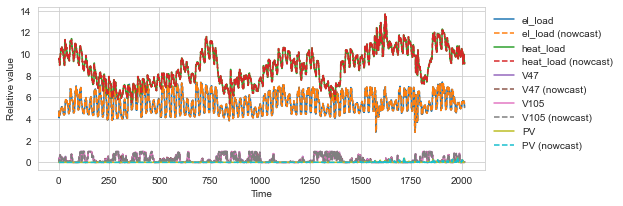

In [139]:
import matplotlib.dates as mdates
plt.figure(figsize=(8,3))
ax=plt.gca()
#day 6, hour 22: 6*24*12 + 22*12 = 
#tstart=7*24*12
#tlen=12*12
#xvalues = pd.date_range(start="00:00:00",freq="5min",periods=tlen)
#myFmt = mdates.DateFormatter('%H:%M')
#ax.xaxis.set_major_formatter(myFmt)
tstart=0
tlen=7*24*12
xvalues=range(tstart,tstart+tlen)
print(tstart,tlen)
for pr in profiles:
    if pr.id in ["curve_const","waterinj","h2target"]: continue
    color = next(ax._get_lines.prop_cycler)['color']
    plt.step(xvalues,pr.data[tstart:(tstart+tlen)],label=pr.id,color=color,where="post")
    if pr.data_nowcast is not None:
        color = next(ax._get_lines.prop_cycler)['color']
        plt.step(xvalues,pr.data_nowcast[tstart:(tstart+tlen)],"--",
                 label="{} (nowcast)".format(pr.id),color=color,where="post")        
plt.legend(loc="upper left",bbox_to_anchor=(1,1),frameon=False)
plt.xlabel("Time")
plt.ylabel("Relative value")
plt.savefig(outpath+"timerseries_ts{}_{}.pdf".format(tstart,case),dpi=300,bbox_inches="tight")

In [140]:
outpath

'result/'

In [141]:
# View profiles (entire available time windows)
scale=300/96 # ratio print vs screen dpi
fig=plots.plot_profiles(profiles,filename=None)
#fig.update_layout(template="plotly_white",autosize=False,width=600,height=200,margin=dict(l=0,r=0,t=0,b=0))
fig.show()
#300 dpi and 4 inch: 1200 pixels
#fig.write_image(outpath+"profiles.pdf",width=600,height=200,scale=scale)

In [142]:
dev=simulator.optimiser.all_devices['wind'].dev_data
#fuelA = dev.fuel_A
#fuelB = dev.fuel_B
Pmax = dev.flow_max
#plots.plotGasTurbineEfficiency(filename='gasturbine_Gen1.png',fuelA=fuelA,fuelB=fuelB,Pmax=Pmax)

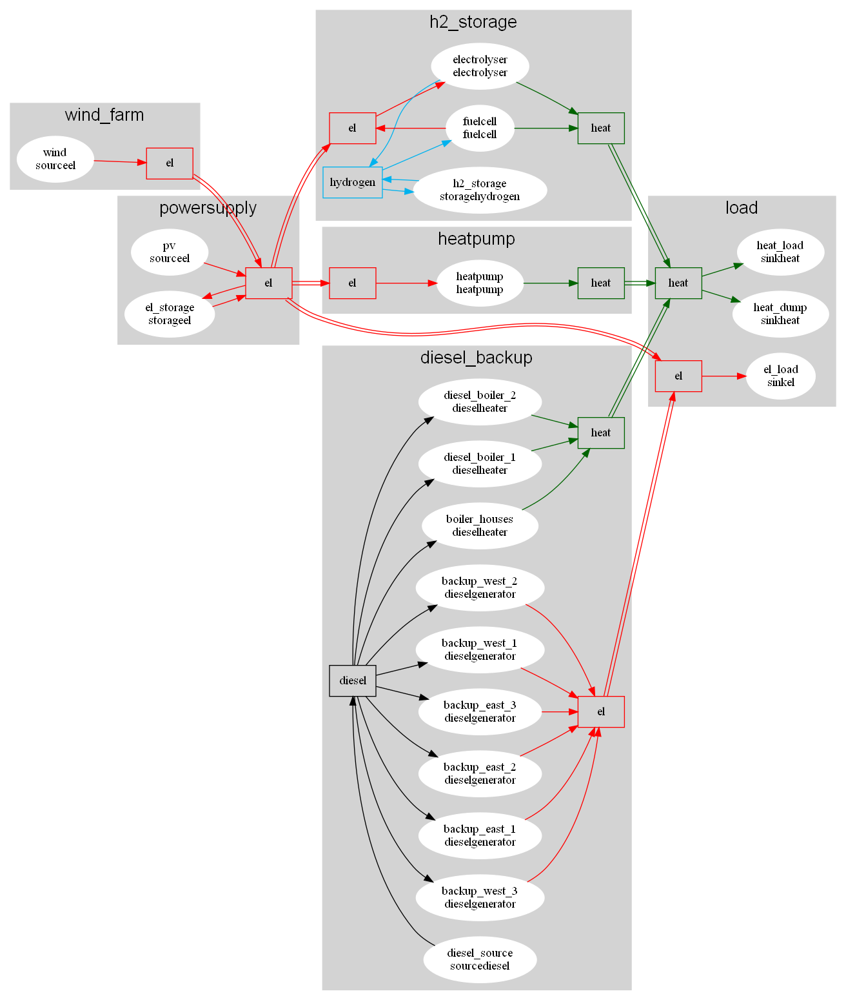

In [143]:
# View energy system
dotG=plots.plot_network(simulator,timestep=None,filename=None,rank_direction="LR",hide_edgelabel=True,only_carrier=None,fontsize=20,fontname = "helvetica",)
IPython.display.Image(dotG.create_png(prog="dot")) #scales automatically to page width
#dotG.write_pdf(path=outpath+"diagram0_{}.pdf".format(case))

### Some checks on input data

In [144]:
25.12, 25.063, 25.081

(25.12, 25.063, 25.081)

In [145]:
print(simulator.optimiser.all_edges['heat_hp_load'].edge_data)

id='heat_hp_load' node_from='heatpump' node_to='load' length_km=None flow_max=None bidirectional=True include=True carrier=<CarrierType.HEAT: 'heat'> power_loss_function=None


In [146]:
print(simulator.optimiser.all_devices["backup_east_1"].compute_operating_costs(simulator.optimiser,[0,1]))

(0.01*varDeviceFlow[backup_east_1,el,out,0] + 0.01*varDeviceFlow[backup_east_1,el,out,1])/2


## Solve

If the problem is infeasible, try 
* relaxing pressure deviation limits (generic value and per-node value)
* add a high cost emergency generator (that could represent load shedding) to ensure energy balance can be satisfied
* make sure excess heat/water/gas has a place to go


In [147]:
dev_d=simulator.optimiser.all_devices["wind"].dev_data
node_d=simulator.optimiser.all_nodes["powersupply"].node_data

In [148]:
#simulator.optimiser.write("testplatform.mps")
sim_result = simulator.run_simulation(solver="gurobi",time_range=timerange,write_yaml=False,time_limit=15)
print("Mean CO2 emission rate      = {:.1f} kgCO2/s".format(sim_result.co2_rate.mean()))
print("Mean CO2 emission intensity = {:.1f} kgCO2/Sm3oe".format(sim_result.co2_intensity.mean()))
#print("Mean export revenue         =",*["{}:{:.1f} ".format(x,v) for x,v in sim_result.export_revenue.mean().items() if v!=0],"$/s")

 30%|██▉       | 105/355 [18:02<55:47, 13.39s/it]  

In [ ]:
print(sim_result.op_cost.to_string())

0       1.752700
1       0.287201
2       0.652421
3       1.756200
4       1.749850
5       1.750350
6       1.749000
7       1.748400
8       0.360200
9       0.360200
10      0.366450
11      0.366450
12      0.366450
13      0.367850
14      0.371450
15      0.370550
16      0.369500
17      0.369500
18      0.366650
19      0.365450
20      0.363950
21      0.360350
22      0.357350
23      0.351650
24      0.179188
25      0.074843
26      0.079955
27      0.107085
28      0.122824
29      0.172671
30      0.080186
31      0.170610
32      0.155084
33      0.143964
34      0.167126
35      0.230691
36      0.245874
37      0.295623
38      0.297444
39      0.297954
40      0.299189
41      0.257211
42      0.231685
43      0.259695
44      0.234672
45      0.244214
46      0.235570
47      0.215053
48      1.735400
49      1.618088
50      1.747717
51      1.798996
52      1.763676
53      1.752600
54      1.746750
55      1.740350
56      1.704850
57      1.748543
58      0.3985

In [ ]:
print(sim_result.op_cost_per_dev)

device         time
backup_east_1  0            0.0
               1            0.0
               2            0.0
               3            0.0
               4            0.0
                         ...   
wind           8515    0.103124
               8516    0.083487
               8517    0.053953
               8518    0.035832
               8519    0.019393
Length: 170400, dtype: object


In [ ]:
sim_result.device_flow.wind.el.out

time
0        0.000000
1        0.000000
2        0.000000
3        0.000000
4        0.000000
          ...    
8515    34.374787
8516    27.829029
8517    17.984211
8518    11.943845
8519     6.464390
Length: 8520, dtype: float64

In [ ]:
sim_result.profiles_nowcast.V105

0       0.301688
1       0.195424
2       0.109956
3       0.066535
4       0.456764
          ...   
8755    0.041177
8756    0.023998
8757    0.000416
8758    0.036941
8759    0.152311
Name: V105, Length: 8760, dtype: float64

In [ ]:
sim_result.device_flow.diesel_source.diesel.out[152]

0.0

In [ ]:
sim_result.device_flow.boiler_houses.heat.out[152]

0.0

In [ ]:
import numpy as np
timestep = 0
timelimit = 24*7
df_op_cost_sum = pd.Series(dtype=np.float64, index=range(timestep, timestep + timelimit))
for t in range(timelimit):
    df_op_cost_sum.loc[t + timestep] = pyo.value(simulator.optimiser.compute_operating_costs(simulator.optimiser, timesteps=[t]))
df_op_cost_sum.index.rename("time", inplace=True)

In [ ]:
df_op_cost_sum

time
0      0.221318
1      0.249219
2      0.119286
3      0.056480
4      0.337025
         ...   
163    1.304105
164    1.216450
165    1.209671
166    1.175613
167    1.094189
Length: 168, dtype: float64

In [ ]:
print(df_op_cost_sum)

time
0      0.221318
1      0.249219
2      0.119286
3      0.056480
4      0.337025
         ...   
163    1.304105
164    1.216450
165    1.209671
166    1.175613
167    1.094189
Length: 168, dtype: float64


In [ ]:
from tqdm import trange
time_start = timerange[0]
time_end = timerange[1]
steps = simulator.optimiser.optimisation_parameters.optimisation_timesteps
timelimit = simulator.optimiser.optimisation_parameters.optimisation_timesteps
for timestep in trange(time_start, time_end, steps):
    df_co2_rate_sum = pd.Series(dtype=np.float64, index=range(timestep, timestep + timelimit))
    for t in range(timelimit):
        df_co2_rate_sum.loc[t + timestep] = pyo.value(simulator.optimiser.compute_CO2(simulator.optimiser, timesteps=[t]))
    df_co2_rate_sum.index.rename("time", inplace=True)

100%|██████████| 355/355 [00:01<00:00, 299.58it/s]


In [ ]:
sum(df_co2_rate_sum)/timelimit

0.054144122260774814

In [ ]:
sim_result.co2_intensity

0      NaN
1      NaN
2      NaN
3      NaN
4      NaN
        ..
8515   NaN
8516   NaN
8517   NaN
8518   NaN
8519   NaN
Length: 8520, dtype: float64

In [ ]:
sim_result.co2_rate

0       0.0
1       0.0
2       0.0
3       0.0
4       0.0
       ... 
8515    0.0
8516    0.0
8517    0.0
8518    0.0
8519    0.0
Length: 8520, dtype: float64

In [ ]:
simulator.optimiser.optimisation_parameters.planning_horizon

240

In [ ]:
sum(sim_result.co2_rate*3600) #co2-emissions for the entire simulation period [kg]

8668814.078087606

In [ ]:
print(simulator.optimiser.all_devices['backup_east_1'].compute_CO2(simulator.optimiser, [1]))

2640.0*varDeviceFlow[backup_east_1,diesel,in,1]


In [ ]:
simulator.optimiser.all_devices['backup_east_1'].dev_data.start_stop == None

False

In [ ]:
#simulator.optimiser.updateOptimisationModel(timestep=0,profiles=data.profiles,first=True)
simulator.optimiser.write("test.mps",io_options = {"symbolic_solver_labels":True})

('test.mps', 1830884376288)

In [ ]:
#simulator.optimiser.constr_injectionwell_Pmax.pprint()
#simulator.optimiser.constrO_elReserveMargin[6].pprint()
pyo.value(simulator.optimiser.varEdgeFlow["el_ps_load",10])
#simulator.optimiser.constrE_w2_flow.pprint()

6.23

In [ ]:
print(pyo.value(simulator.optimiser.paramProfiles["V105",1]),
    pyo.value(simulator.optimiser.varDeviceIsOn["wind",6]),
    pyo.value(simulator.optimiser.varDeviceIsOn["electrolyser",6]),
    pyo.value(simulator.optimiser.varDeviceIsOn["heatpump",6]),
)

0.6553384800800776 1 1 1


## Save/Load simulation results
By saving to pickle file, it easy to later open and analyse the results without having to re-run the simulation

In [ ]:
pickle_save='{}case{}.pkl'.format(outpath,case)
# Save (pickle) - for later opening and analysis
dumpdata={"data":data,"result":sim_result}
with open(pickle_save, mode='wb') as file:
   pickle.dump(dumpdata, file)
print("Results were saved to {}".format(pickle_save))

Results were saved to result/case_br_offshore_pv_diesel_2018.pkl


In [ ]:
# Open previously saved object (including simulation results)
#with open(pickle_save, mode='rb') as file:
#   sim_data = cloudpickle.load(file)
#data=sim_data["data"]
#sim_result=sim_data["result"]

## Analyse results

In [ ]:
import oogeso.result_analysis
kpi = oogeso.result_analysis.compute_kpis(sim_result, sim_data=data, fuel_carrier = "diesel")#, windturbines=['wind'])
kpi = pd.DataFrame.from_dict(kpi,orient="index",columns=[case])
kpi

,_br_offshore_pv_diesel_2018
hours_simulated,8.520000e+03
kgCO2_per_year,8.913006e+06
kgCO2_per_Sm3oe,NaN
fuel_sm3_per_year,3.376139e+03
elconsumption_mwh_per_year,1.022698e+05
elconsumption_avg_mw,1.167463e+01
gt_starts_per_year,2.961127e+02
gt_stops_per_year,2.961127e+02
gt_hoursrunning_per_year,6.754042e+03
wind_output_mwh_per_year,0.000000e+00


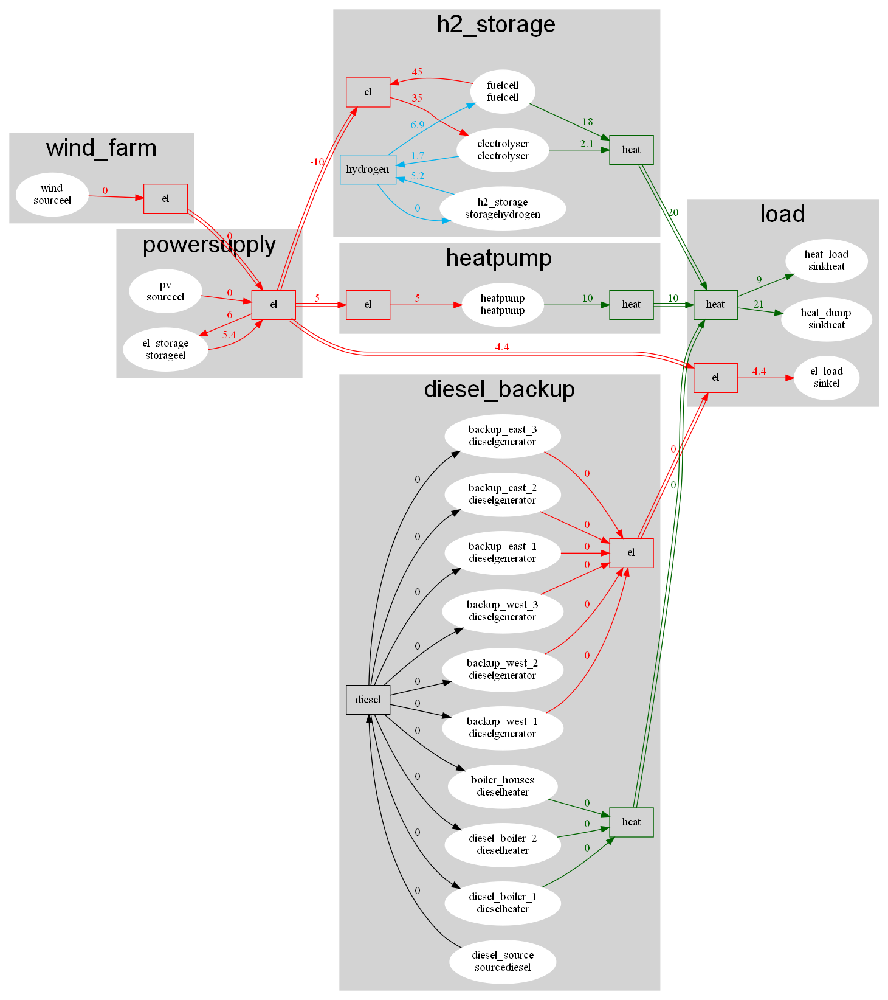

In [ ]:
tstep=4
gCombined = plots.plot_network(simulator=simulator,timestep=tstep,numberformat="{:.3g}",
                              filename=None,only_carrier=None,fontsize=30,fontname = "helvetica",
                              hide_losses=True)
IPython.display.Image(gCombined.create_png())
#gCombined.write_png(path=outpath+"diagram_{}.pdf".format(case),f="pdf")
#gCombined.write_pdf(path=outpath+"diagram_{}.pdf".format(case))

In [ ]:
print(sim_result.device_flow.el_load.el["in"].to_string())

time
0       4.73000
1       4.12000
2       4.46000
3       4.38000
4       4.43000
5       4.38000
6       4.51500
7       4.57500
8       4.75500
9       4.75500
10      4.96333
11      4.96333
12      4.96333
13      5.01000
14      5.13000
15      5.10000
16      5.06500
17      5.06500
18      4.97000
19      4.93000
20      4.88000
21      4.76000
22      4.66000
23      4.47000
24      4.52000
25      4.38000
26      4.40000
27      4.40000
28      4.42000
29      4.51000
30      4.52000
31      5.00000
32      5.53800
33      5.64000
34      5.78000
35      5.75500
36      5.75500
37      5.73000
38      5.58500
39      5.54900
40      5.65700
41      5.63000
42      5.45000
43      5.40000
44      5.25000
45      5.22000
46      5.40000
47      4.96000
48      4.64000
49      4.50000
50      4.64333
51      4.50333
52      4.65333
53      4.74000
54      4.74000
55      5.38000
56      6.08000
57      6.79000
58      6.76000
59      6.76000
60      6.56000
61      6.70000
62 

In [ ]:
print(sim_result.device_flow.heat_dump.to_string())

carrier   terminal  time
diesel    in        0       0.000000e+00
                    1       0.000000e+00
                    2       0.000000e+00
                    3       0.000000e+00
                    4       0.000000e+00
                    5       0.000000e+00
                    6       0.000000e+00
                    7       0.000000e+00
                    8       0.000000e+00
                    9       0.000000e+00
                    10      0.000000e+00
                    11      0.000000e+00
                    12      0.000000e+00
                    13      0.000000e+00
                    14      0.000000e+00
                    15      0.000000e+00
                    16      0.000000e+00
                    17      0.000000e+00
                    18      0.000000e+00
                    19      0.000000e+00
                    20      0.000000e+00
                    21      0.000000e+00
                    22      0.000000e+00
                    23      0.00

In [ ]:
#simulator.optimiser.all_nodes['wells'].devices_serial
#sim_result.dfEdgeFlow.unstack("edge").loc[151]
#simulator.optimiser.constrN_wells_energybalance["gas","out",0].pprint()
#print(pyo.value(simulator.optimiser.varDeviceFlow["wellL1","gas","out",0]))
#print(pyo.value(simulator.optimiser.varDeviceFlow["wellL2","gas","out",0]))
#print(pyo.value(simulator.optimiser.varEdgeFlow["cL2g",0]))
#print(pyo.value(simulator.optimiser.varEdgeLoss21["cL2g",0]))

In [ ]:
plots.plotter='matplotlib'
fig2=plots.plot_sum_power_mix(sim_result,simulator.optimiser,carrier="el")#,filename=None,devs_shareload=["wind","pv"])#['Gen1','Gen2','Gen3'])
#fig2.update_layout(autosize=False,width=800,height=500,margin=dict(l=0,r=0,t=0,b=0))
#fig2.write_image("{}/elpowermix_{}.png".format(outpath,case))
#fig2.set_size_inches(6,4)
plt.suptitle("")
fig2.show()
plt.savefig("result/poweroutput_{}x.pdf".format(case),dpi=300,bbox_inches="tight")

<Figure size 432x288 with 0 Axes>

In [ ]:
plots.plotter="plotly"
gts = [d for d,d_obj in simulator.optimiser.all_devices.items() if d_obj.dev_data.model in ["dieselgenerator","source_el"]]
fig=plots.plot_device_profile(sim_result,simulator.optimiser,devs=gts,filename=None,include_on_off=True, include_prep=False,devs_shareload=None)
fig.update_layout(autosize=False,width=700,height=300,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white",
                 title="Power supply and on/off status (case: {})".format(case))
fig.show()

,el,heat
device,,
backup_east_1,0.000000,0.000000
backup_east_2,0.000000,0.000000
backup_east_3,0.000000,0.000000
backup_west_1,0.000000,0.000000
backup_west_2,0.000000,0.000000
backup_west_3,0.000000,0.000000
boiler_houses,0.000000,0.000000
diesel_boiler_1,0.000000,0.000000
diesel_boiler_2,0.000000,0.000000


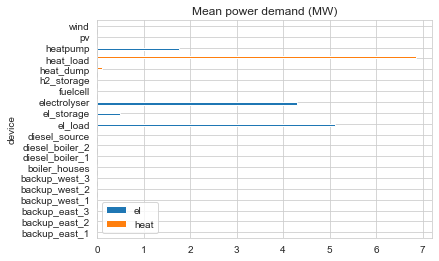

In [ ]:
mean_el_demand = sim_result.device_flow.unstack('carrier')['el'].unstack('terminal')['in'].dropna().unstack().T.mean()
mean_heat_demand = sim_result.device_flow.unstack('carrier')['heat'].unstack('terminal')['in'].dropna().unstack().T.mean()
energydemand = pd.concat({'el':mean_el_demand,'heat':mean_heat_demand},axis=1)
#energydemand.drop('heatdump',inplace=True)
energydemand.plot.barh(title="Mean power demand (MW)")
energydemand

In [ ]:
energydemand.sum()

el      11.674632
heat     6.967499
dtype: float64

In [ ]:
mean_flows=sim_result.device_flow.unstack(["carrier","device","terminal"]).mean().unstack(["carrier","terminal"])
print("Mean flows:\n",mean_flows.sum())
print("Mean flow per device:")
mean_flows

Mean flows:
 carrier   terminal
diesel    in           0.000107
          out          0.000107
el        in          11.674632
          out         11.674632
heat      in           6.967499
          out          6.967499
hydrogen  in           0.461905
          out          0.461905
dtype: float64
Mean flow per device:


carrier                diesel                  el                heat  \
terminal                   in       out        in       out        in   
device                                                                  
backup_east_1    1.736000e-07  0.000000  0.000000  0.002354  0.000000   
backup_east_2    4.000418e-08  0.000000  0.000000  0.000539  0.000000   
backup_east_3    1.193735e-07  0.000000  0.000000  0.001609  0.000000   
backup_west_1    1.575556e-05  0.000000  0.000000  0.214714  0.000000   
backup_west_2    1.037523e-05  0.000000  0.000000  0.141394  0.000000   
backup_west_3    9.120612e-06  0.000000  0.000000  0.124298  0.000000   
boiler_houses    0.000000e+00  0.000000  0.000000  0.000000  0.000000   
diesel_boiler_1  5.808644e-05  0.000000  0.000000  0.000000  0.000000   
diesel_boiler_2  1.338584e-05  0.000000  0.000000  0.000000  0.000000   
diesel_source    0.000000e+00  0.000107  0.000000  0.000000  0.000000   
el_load          0.000000e+00  0.000000  5.121251  0.000000  0.000000   
el_storage       0.000000e+00  0.000000  0.486273  0.438617  0.000000   
electrolyser     0.000000e+00  0.000000  4.301057  0.000000  0.000000   
fuelcell         0.000000e+00  0.000000  0.000000  1.658732  0.000000   
h2_storage       0.000000e+00  0.000000  0.000000  0.000000  0.000000   
heat_dump        0.000000e+00  0.000000  0.000000  0.000000  0.111800   
heat_load        0.000000e+00  0.000000  0.000000  0.000000  6.855699   
heatpump         0.000000e+00  0.000000  1.766052  0.000000  0.000000   
pv               0.000000e+00  0.000000  0.000000  1.805228  0.000000   
wind             0.000000e+00  0.000000  0.000000  7.287146  0.000000   

carrier                    hydrogen            
terminal              out        in       out  
device                                         
backup_east_1    0.000000  0.000000  0.000000  
backup_east_2    0.000000  0.000000  0.000000  
backup_east_3    0.000000  0.000000  0.000000  
backup_west_1    0.000000  0.000000  0.000000  
backup_west_2    0.000000  0.000000  0.000000  
backup_west_3    0.000000  0.000000  0.000000  
boiler_houses    0.000000  0.000000  0.000000  
diesel_boiler_1  2.038834  0.000000  0.000000  
diesel_boiler_2  0.469843  0.000000  0.000000  
diesel_source    0.000000  0.000000  0.000000  
el_load          0.000000  0.000000  0.000000  
el_storage       0.000000  0.000000  0.000000  
electrolyser     0.263225  0.000000  0.211744  
fuelcell         0.663493  0.255190  0.000000  
h2_storage       0.000000  0.206716  0.250161  
heat_dump        0.000000  0.000000  0.000000  
heat_load        0.000000  0.000000  0.000000  
heatpump         3.532105  0.000000  0.000000  
pv               0.000000  0.000000  0.000000  
wind             0.000000  0.000000  0.000000

In [ ]:
plots.plotter="plotly"
gts = [d for d,d_obj in simulator.optimiser.all_devices.items() if d_obj.dev_data.model in ["sourceel"]]
fig=plots.plot_device_profile(sim_result,simulator.optimiser,devs=gts,filename=None,include_on_off=False,include_prep=False,devs_shareload=None)
#fig.update_layout(autosize=False,width=700,height=300,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.show()
#300 dpi and 4 inch: 1200 pixels
scale=300/96 # ratio print vs screen dpi
#fig.write_image(outpath+"powersupply.pdf",width=700,height=300,scale=scale)

In [ ]:
 df = sim_result.device_flow.unstack(["carrier", "terminal"])[("el", "out")].unstack("device")
 df.index

Int64Index([   0,    1,    2,    3,    4,    5,    6,    7,    8,    9,
            ...
            8510, 8511, 8512, 8513, 8514, 8515, 8516, 8517, 8518, 8519],
           dtype='int64', name='time', length=8520)

In [ ]:
import plotly
fig = plotly.subplots.make_subplots(rows=1, cols=1, shared_xaxes=True)
fig.add_scatter(
                x=df.index,
                y=df["wind"],
                line_shape="hv",
                name="wind",
                #line=dict(color=colour[k]),
                stackgroup="P",
                legendgroup="wind",
                row=1,
                col=1,
            )

In [ ]:
dfStartopt = pd.DataFrame()
inst=simulator.optimiser
for t in inst.setHorizon: 
    dfStartopt.loc[t,'start']=inst.varDeviceStarting['wind',t].value
    dfStartopt.loc[t,'prep']=inst.varDeviceIsPrep['heatpump',t].value
    dfStartopt.loc[t,'on']=inst.varDeviceIsOn['electrolyser',t].value
    dfStartopt.loc[t,'stop']=inst.varDeviceStopping['fuelcell',t].value
dfStartopt.head()

,start,prep,on,stop
0,NaN,0.0,1.0,NaN
1,NaN,0.0,1.0,NaN
2,NaN,0.0,1.0,NaN
3,NaN,0.0,1.0,NaN
4,NaN,0.0,1.0,NaN


In [ ]:
fig=plots.plot_device_profile(sim_result,simulator.optimiser,devs=['wind'],filename=None,include_forecasts=True)
fig.update_layout(autosize=False,width=800,height=300,margin=dict(l=0,r=0,t=0,b=0))

In [ ]:
"""
df=sim_result.device_flow.unstack([0,1,2])[[('ex_g','gas','in'),('ex_o','oil','in')]]
df.columns=['gas','oil']
df=df.reset_index()
df["gas"]=df["gas"]/1000 # convert to oil equivalents
df = df.melt(var_name="Product",value_name="Volume rate (Sm3oe/s)",id_vars=('time'))
px.line(df,x="time",y="Volume rate (Sm3oe/s)",color="Product",title="Oil/gas export volumes (Sm3oe/s)").show()

plots.plot_export_revenue(sim_result)
"""

'\ndf=sim_result.device_flow.unstack([0,1,2])[[(\'ex_g\',\'gas\',\'in\'),(\'ex_o\',\'oil\',\'in\')]]\ndf.columns=[\'gas\',\'oil\']\ndf=df.reset_index()\ndf["gas"]=df["gas"]/1000 # convert to oil equivalents\ndf = df.melt(var_name="Product",value_name="Volume rate (Sm3oe/s)",id_vars=(\'time\'))\npx.line(df,x="time",y="Volume rate (Sm3oe/s)",color="Product",title="Oil/gas export volumes (Sm3oe/s)").show()\n\nplots.plot_export_revenue(sim_result)\n'

In [ ]:
simulator.optimiser.setDevice.pprint()

setDevice : device
    Size=1, Index=None, Ordered=Insertion
    Key  : Dimen : Domain : Size : Members
    None :     1 :    Any :   20 : {'wind', 'pv', 'el_load', 'heat_load', 'electrolyser', 'fuelcell', 'h2_storage', 'el_storage', 'heatpump', 'heat_dump', 'diesel_source', 'backup_east_1', 'backup_east_2', 'backup_east_3', 'backup_west_1', 'backup_west_2', 'backup_west_3', 'diesel_boiler_1', 'diesel_boiler_2', 'boiler_houses'}


In [ ]:
plots.plotter="plotly"
if 'el_storage' in simulator.optimiser.setDevice:
    fig=plots.plot_device_power_energy(sim_result,simulator.optimiser,'el_storage',
                                 filename=None)#outpath+"battery_opt.png")
    fig.update_layout(autosize=False,width=800,height=300,margin=dict(l=0,r=0,t=30,b=0)).show()
#    oogeso.plots.optimization_plots.plot_device_power_last_optimisation_1(mc,device='battery', filename=None)#outpath+"lastopt_battery.png")

In [ ]:
plots.plotter="plotly"
if 'h2_storage' in simulator.optimiser.setDevice:
    fig=plots.plot_device_power_energy(sim_result,simulator.optimiser,'h2_storage',
                                 filename=None)#outpath+"battery_opt.png")
    #fig.update_layout(autosize=False,width=800,height=300,margin=dict(l=0,r=0,t=30,b=0)).show()
    fig.show()

In [ ]:
simulator.optimiser.all_devices["h2_storage"].dev_data.model

<ModelType.STORAGE_HYDROGEN: 'storagehydrogen'>

In [ ]:
plots.plotter="plotly"
#fig=plots.plot_co2_rate_per_dev(sim_result,simulator.optimiser,reverseLegend=True,filename=outpath+"co2rate_opt.png",devs_shareload=gts)
#fig.update_layout(autosize=False,width=800,height=300,margin=dict(l=0,r=0,t=0,b=0))

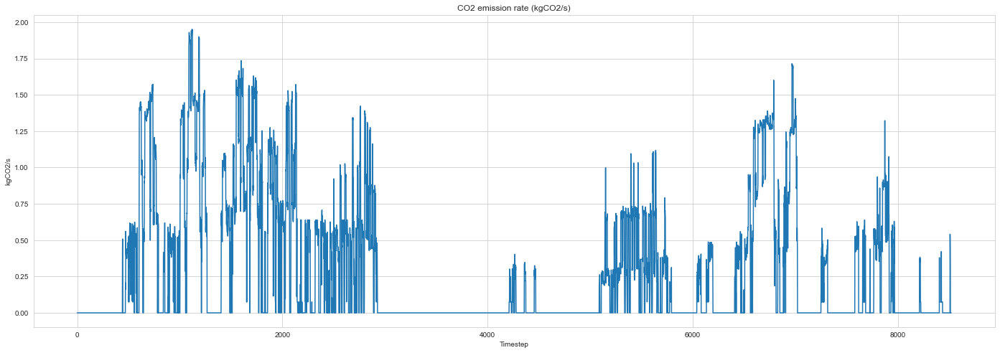

In [ ]:
fig = plots.plot_CO2_rate(sim_result)

In [ ]:
fig=plots.plot_CO2_intensity(sim_result,filename=outpath+"co2intensity_opt.png")
fig.update_layout(autosize=False,width=700,height=300,margin=dict(l=0,r=0,t=0,b=0))

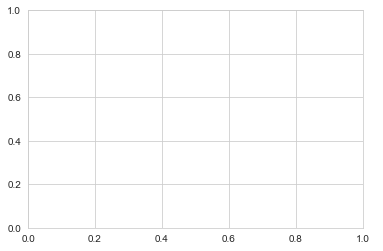

In [ ]:
plots.plotter="matplotlib"
fig=plots.plot_reserve(sim_result,simulator.optimiser,dynamic_margin=True,include_sum=False)
plt.legend(loc="upper left",bbox_to_anchor=(1,1),frameon=False)
#fig.set_size_inches(5.92,1.5)
plt.savefig("result/reserve_{}x.pdf".format(case),dpi=300,bbox_inches="tight")
#fig.update_layout(autosize=False,width=700,height=200,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
#fig.update_layout(legend_traceorder="reversed")
#fig.show()
#300 dpi and 4 inch: 1200 pixels
#scale=300/96 # ratio print vs screen dpi
#fig.write_image(outpath+"reserve.pdf",width=700,height=200,scale=scale)

In [ ]:
# This plot shows per device its output (dotted line) and the available online backup, iel reserve 
# by _other_ devices (solid line). MARGIN(t) = min_devices(backup(t) - output(t))
plots.plot_el_backup(sim_result,show_margin=True,return_margin=False)

In [ ]:
fig=plots.plot_device_power_energy(sim_result,simulator.optimiser,"h2_storage")
fig.update_layout(autosize=False,width=800,height=250,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.update_yaxes(tick0=0, dtick=1,secondary_y=True,range=[0,5.5])
fig.update_yaxes(tick0=0, dtick=100e3,secondary_y=False,range=[0,550e3])
fig.show()
fig.write_image(outpath+"h2_storage_{}.pdf".format(case))

In [ ]:
simulator.optimiser.all_devices

{'wind': <oogeso.core.devices.source.SourceEl at 0x1aa070e2ef0>,
 'pv': <oogeso.core.devices.source.SourceEl at 0x1aa070e2aa0>,
 'el_load': <oogeso.core.devices.sink.SinkEl at 0x1aa070e2950>,
 'heat_load': <oogeso.core.devices.sink.SinkHeat at 0x1aa070e29e0>,
 'electrolyser': <oogeso.core.devices.electrolyser.Electrolyser at 0x1aa070e35e0>,
 'fuelcell': <oogeso.core.devices.fuelcell.FuelCell at 0x1aa070e2920>,
 'h2_storage': <oogeso.core.devices.storage.StorageHydrogen at 0x1aa070e1330>,
 'el_storage': <oogeso.core.devices.storage.StorageEl at 0x1aa070e10f0>,
 'heatpump': <oogeso.core.devices.heatpump.HeatPump at 0x1aa070e28f0>,
 'heat_dump': <oogeso.core.devices.sink.SinkHeat at 0x1aa070e0e20>,
 'diesel_source': <oogeso.core.devices.source.SourceDiesel at 0x1aa070e1cc0>,
 'backup_east_1': <oogeso.core.devices.dieselgenerator.DieselGenerator at 0x1aa070e1f30>,
 'backup_east_2': <oogeso.core.devices.dieselgenerator.DieselGenerator at 0x1aa070e2590>,
 'backup_east_3': <oogeso.core.device